# Temperature Forecast Project using ML

In [70]:
import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")
import joblib
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import metrics
from scipy.stats import zscore
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

In [71]:
df=pd.read_csv("temp.csv")

In [72]:
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.000000,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.000000,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,0.059869,0.000000,0.000796,0.000000,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


# Exploratory Data Analysis(EDA)

In [73]:
df.columns.tolist()

['station',
 'Date',
 'Present_Tmax',
 'Present_Tmin',
 'LDAPS_RHmin',
 'LDAPS_RHmax',
 'LDAPS_Tmax_lapse',
 'LDAPS_Tmin_lapse',
 'LDAPS_WS',
 'LDAPS_LH',
 'LDAPS_CC1',
 'LDAPS_CC2',
 'LDAPS_CC3',
 'LDAPS_CC4',
 'LDAPS_PPT1',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'lat',
 'lon',
 'DEM',
 'Slope',
 'Solar radiation',
 'Next_Tmax',
 'Next_Tmin']

In [74]:
df.info

<bound method DataFrame.info of       station        Date  Present_Tmax  Present_Tmin  LDAPS_RHmin  \
0         1.0  30-06-2013          28.7          21.4    58.255688   
1         2.0  30-06-2013          31.9          21.6    52.263397   
2         3.0  30-06-2013          31.6          23.3    48.690479   
3         4.0  30-06-2013          32.0          23.4    58.239788   
4         5.0  30-06-2013          31.4          21.9    56.174095   
...       ...         ...           ...           ...          ...   
7747     23.0  30-08-2017          23.3          17.1    26.741310   
7748     24.0  30-08-2017          23.3          17.7    24.040634   
7749     25.0  30-08-2017          23.2          17.4    22.933014   
7750      NaN         NaN          20.0          11.3    19.794666   
7751      NaN         NaN          37.6          29.9    98.524734   

      LDAPS_RHmax  LDAPS_Tmax_lapse  LDAPS_Tmin_lapse   LDAPS_WS    LDAPS_LH  \
0       91.116364         28.074101         23.

In [75]:
df.shape # rows and columns in data

(7752, 25)

In [76]:
df.dtypes #Checking the datatype of each attribute

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [77]:
df.isnull().sum().sort_values(ascending=False)

LDAPS_CC3           75
LDAPS_PPT4          75
LDAPS_PPT2          75
LDAPS_PPT1          75
LDAPS_CC4           75
LDAPS_CC2           75
LDAPS_CC1           75
LDAPS_LH            75
LDAPS_WS            75
LDAPS_Tmin_lapse    75
LDAPS_Tmax_lapse    75
LDAPS_RHmax         75
LDAPS_RHmin         75
LDAPS_PPT3          75
Present_Tmin        70
Present_Tmax        70
Next_Tmax           27
Next_Tmin           27
Date                 2
station              2
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
dtype: int64

#### We have missing values present in our dataset columns that will need to be treated now

In [78]:
df.dtypes.value_counts()

float64    24
object      1
dtype: int64

In [79]:
df.dtypes.sort_values(ascending=False)

Date                 object
station             float64
LDAPS_CC4           float64
Next_Tmax           float64
Solar radiation     float64
Slope               float64
DEM                 float64
lon                 float64
lat                 float64
LDAPS_PPT4          float64
LDAPS_PPT3          float64
LDAPS_PPT2          float64
LDAPS_PPT1          float64
LDAPS_CC3           float64
LDAPS_CC2           float64
LDAPS_CC1           float64
LDAPS_LH            float64
LDAPS_WS            float64
LDAPS_Tmin_lapse    float64
LDAPS_Tmax_lapse    float64
LDAPS_RHmax         float64
LDAPS_RHmin         float64
Present_Tmin        float64
Present_Tmax        float64
Next_Tmin           float64
dtype: object

#### except Date every other columns are numerical data type.

In [80]:
df.nunique().to_frame("Unique Values")

,Unique Values
station,25
Date,310
Present_Tmax,167
Present_Tmin,155
LDAPS_RHmin,7672
LDAPS_RHmax,7664
LDAPS_Tmax_lapse,7675
LDAPS_Tmin_lapse,7675
LDAPS_WS,7675
LDAPS_LH,7675


#### With the help of nunique method we were able to check the unique data information present in our dataset columns

In [81]:
pd.set_option('display.max_row',25)
pd.set_option('display.max_column',25)
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


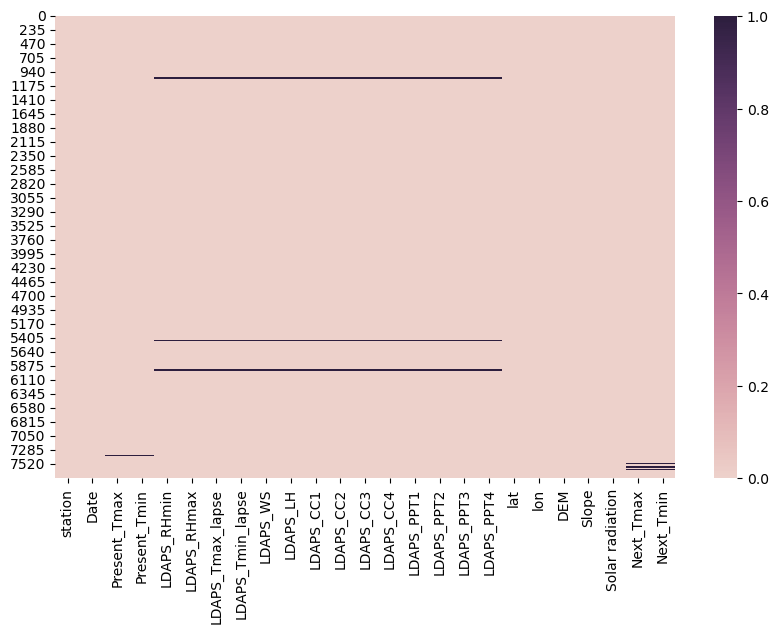

In [82]:
# Lets visualize the null values clearly
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(), cmap=sns.cubehelix_palette(as_cmap=True))
plt.show()


#### The violet lines represents the missing values in the dataset.

In [83]:
# Filling null values in "station" column
df['station'].iloc[7750] = 1.0
df['station'].iloc[7751] = 2.0

In [84]:
# Filling null values in "Date" column
df['Date'].iloc[7750] = '31-08-2017'
df['Date'].iloc[7751] = '31-08-2017'

In [85]:
# Checking skewness
df.skew()

station             0.000182
Present_Tmax       -0.262942
Present_Tmin       -0.365875
LDAPS_RHmin         0.298765
LDAPS_RHmax        -0.850870
LDAPS_Tmax_lapse   -0.226775
LDAPS_Tmin_lapse   -0.578943
LDAPS_WS            1.571581
LDAPS_LH            0.670491
LDAPS_CC1           0.457231
LDAPS_CC2           0.470060
LDAPS_CC3           0.637630
LDAPS_CC4           0.663251
LDAPS_PPT1          5.367675
LDAPS_PPT2          5.747360
LDAPS_PPT3          6.425829
LDAPS_PPT4          6.792379
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.339607
Next_Tmin          -0.403743
dtype: float64

#### The columnsLDAPS_RHmax, LDAPS_Tmin_Lapse, LDAPS_WS, LDAPS_LH,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PP2,LDAPS_PPT3 and LDAPS_PPT4 have skewness which means the data is not symmetric also the outliers are present in those column. So we will use median method to fill the null values in those columns.For the remaining columns we will use mean value to fill the null values.

In [86]:
#statitical summary
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7752.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,12.997033,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,0.356080,0.318404,0.299191,0.591995,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.213007,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,0.258061,0.250362,0.254348,1.945768,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,0.140615,0.101388,0.081532,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,0.312421,0.262555,0.227664,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,0.558694,0.496703,0.499489,0.052525,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


#### The counts of the columns are same which means there are no missing values present in the dataset.

#### In most of the columns, mean is greater than the median(50%),which means theey are skewed to the right.

#### Some column like LDAPS_RHmax, Solar radiation etc, have median values bit greater than the mean value i.e they are skewed to the left

#### Also the columns like station, present_Tmax, lon, lat have same mean and median values which means he dat is normal and symmetric, also they have no skewness.

#### There is a huge difference between the 75th percentile and max, so outliers are present.

In [87]:
# Filling missing values using mean method
cols = ["Present_Tmax","Present_Tmin","LDAPS_RHmin","LDAPS_Tmax_lapse","LDAPS_CC1","LDAPS_CC2","Next_Tmax","Next_Tmin"]
for i in cols:
    df[i] = df[i].replace(np.nan,df[i].mean())

In [88]:
# Filling missing values using median method
cols = ["LDAPS_RHmax","LDAPS_Tmin_lapse","LDAPS_WS","LDAPS_LH","LDAPS_CC3","LDAPS_CC4","LDAPS_PPT1","LDAPS_PPT2","LDAPS_PPT3","LDAPS_PPT4"]
for i in cols:
    df[i] = df[i].replace(np.nan,df[i].median())

In [89]:
# Checking null values again
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

#### here all the null values are sucessfully replaced by mean and median of there closer proxys.

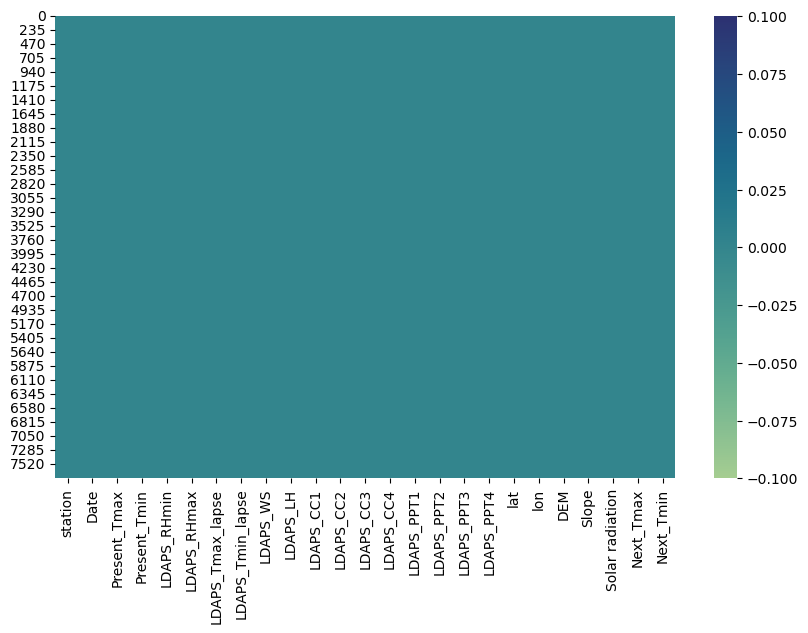

In [90]:
# Lets visualize the null values
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(),cmap="crest")
plt.show()

#### it is clear that there are no missing values present and we can move ahead.

In [91]:
# Converting Date column from object to datetime
df["Date"]= pd.to_datetime(df["Date"])

In [92]:
df.dtypes

station                    float64
Date                datetime64[ns]
Present_Tmax               float64
Present_Tmin               float64
LDAPS_RHmin                float64
LDAPS_RHmax                float64
LDAPS_Tmax_lapse           float64
LDAPS_Tmin_lapse           float64
LDAPS_WS                   float64
LDAPS_LH                   float64
LDAPS_CC1                  float64
LDAPS_CC2                  float64
LDAPS_CC3                  float64
LDAPS_CC4                  float64
LDAPS_PPT1                 float64
LDAPS_PPT2                 float64
LDAPS_PPT3                 float64
LDAPS_PPT4                 float64
lat                        float64
lon                        float64
DEM                        float64
Slope                      float64
Solar radiation            float64
Next_Tmax                  float64
Next_Tmin                  float64
dtype: object

#### The Date column has been converted to Datetime type, now lets extract day, month and year from it.

In [93]:
#extracting day, month and year from date column
df['Day'] = df['Date'].dt.day
df["Month"] = df["Date"].dt.month
df["Year"] = df["Date"].dt.year
#As we have extracted day, month and year, now we can drop Date column.

In [94]:
# Dropping "Date" column
df.drop("Date",axis=1,inplace=True)

In [95]:
df.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,...,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,...,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,30,6,2013
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,...,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,30,6,2013
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,...,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,30,6,2013
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,...,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,30,6,2013
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,...,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,30,6,2013


In [96]:
# Checking the number of unique values in each column
df.nunique()

station           25
Present_Tmax     168
Present_Tmin     156
LDAPS_RHmin     7673
LDAPS_RHmax     7664
                ... 
Next_Tmax        184
Next_Tmin        158
Day               21
Month             12
Year               5
Length: 27, dtype: int64

In [97]:
# Checking the list of counts of Target columns
print(df['Next_Tmax'].value_counts())
print("\n")
print(df['Next_Tmin'].value_counts())

29.3    113
33.0    106
31.3    104
29.6    101
31.2     98
       ... 
37.5      1
38.7      1
37.4      1
20.9      1
21.8      1
Name: Next_Tmax, Length: 184, dtype: int64


23.5    159
23.4    157
24.0    156
23.2    150
23.8    149
       ... 
28.2      1
14.9      1
29.5      1
13.4      1
12.9      1
Name: Next_Tmin, Length: 158, dtype: int64


# Data Visualization

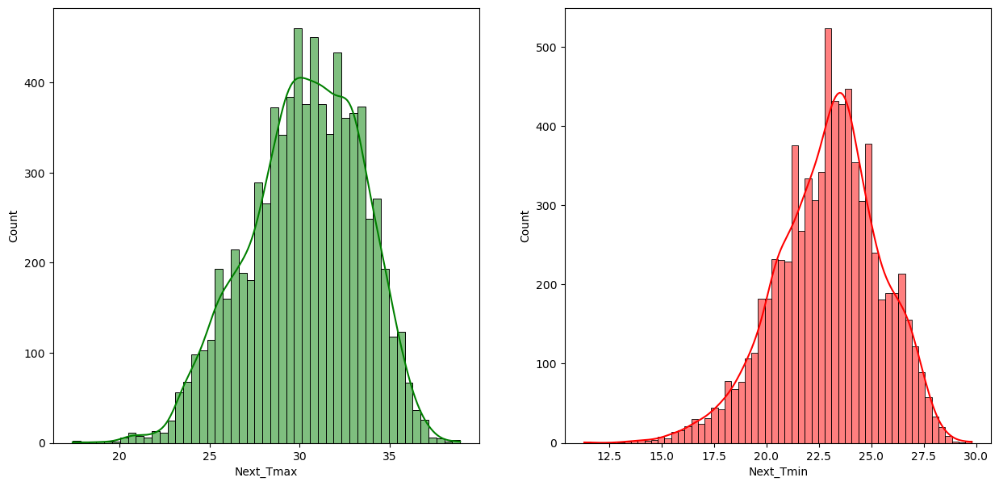

In [98]:
# Plotting histogram for target variables
plt.figure(figsize=(15,7))
plt.subplot(1,2,1)
sns.histplot(df['Next_Tmax'],kde=True,color='g')
plt.subplot(1,2,2)
sns.histplot(df['Next_Tmin'],kde=True,color='r')
plt.show()

#### From the above plot we can observe that the data is normally distributed in both the target variables "Next_Tmax" and "Next_Tmin",and as the data is symmetric, there is no skewness present in these columns.

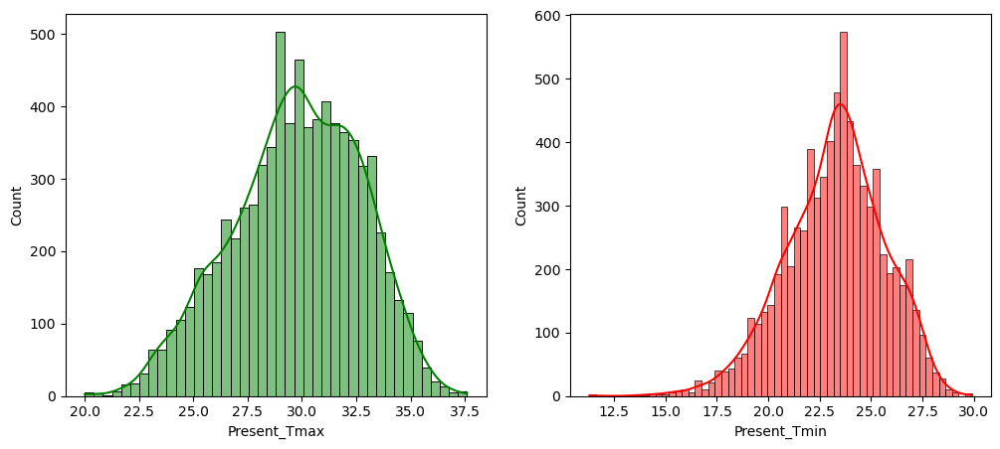

In [99]:
# Plotting histogram for present_Tmax and present_Tmin variables
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['Present_Tmax'],kde=True,color='g')
plt.subplot(1,2,2)
sns.histplot(df['Present_Tmin'],kde=True,color='r')
plt.show()

#### Here also the data is symmetric and normally distributed in both the columns and there is no skewness present.

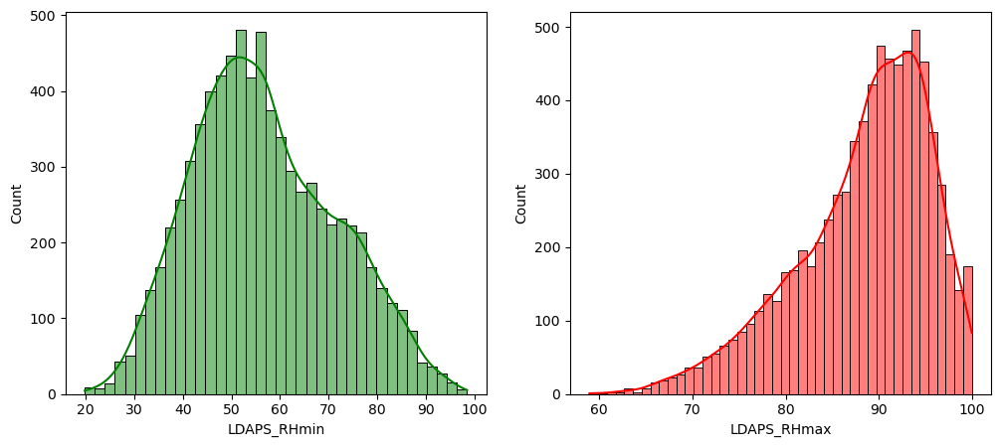

In [100]:
# Plotting histographs for LDAPS_RHmin and LDAPS_RHmax variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['LDAPS_RHmin'],kde=True,color='g')
plt.subplot(1,2,2)
sns.histplot(df['LDAPS_RHmax'],kde=True,color='r')
plt.show()

#### The data is almost normal in LDAPS_RHmax column but it is skewed to the left, since the median is more than the mean.

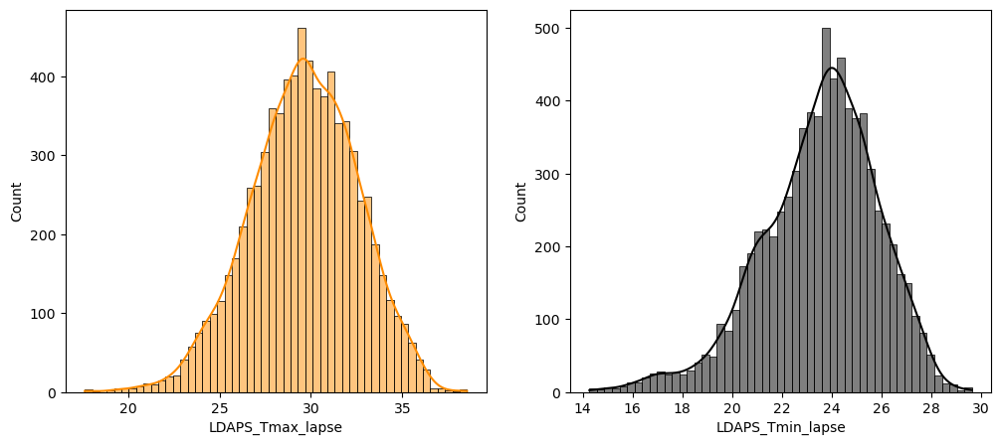

In [101]:
# Plotting histographs for LDAPS_Tmax_lapse and LDAPS_Tmin_lapse variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['LDAPS_Tmax_lapse'],kde=True,color='darkorange')
plt.subplot(1,2,2)
sns.histplot(df['LDAPS_Tmin_lapse'],kde=True,color='black')
plt.show()

#### The data is normally distributed in both the columns.


#### There is no skewness in the column LDAPS_Tmax_lapse but the column LDAPS_Tmin_lapse is bit skewed to left.

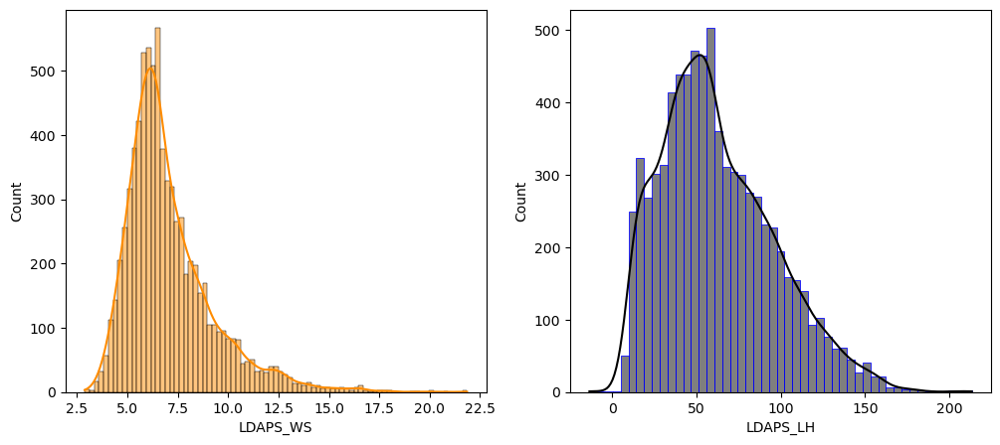

In [102]:
# Plotting histographs for LDAPS_WS and LDAPS_LH variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['LDAPS_WS'],kde=True,color='darkorange')
plt.subplot(1,2,2)
sns.histplot(df['LDAPS_LH'],kde=True,color='black',edgecolor="b")
plt.show()

#### The data is almost normal in both the columns but median is greater than the mean and hence they are skewed to the right.

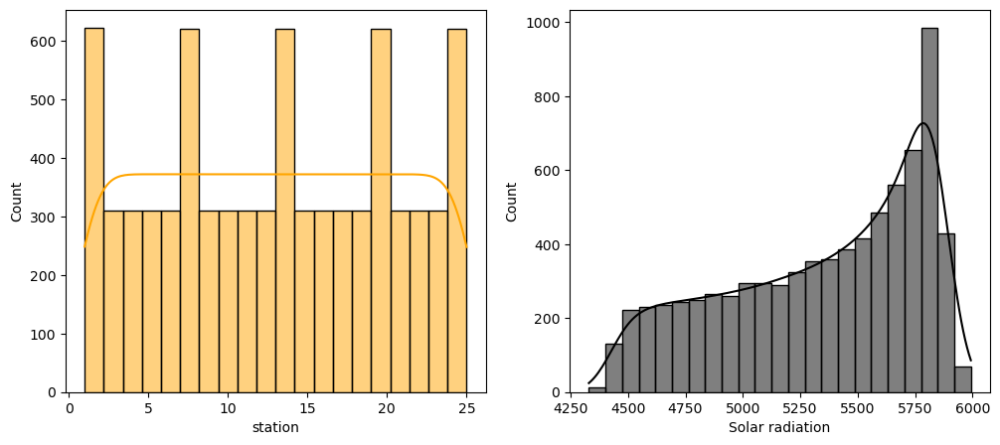

In [103]:
# Plotting histographs for station and Solar radiation variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['station'],kde=True,color='orange')
plt.subplot(1,2,2)
sns.histplot(df['Solar radiation'],kde=True,color="black")
plt.show()

#### The data is normally distributed in station column and there is no skewness present in this column.

#### The mean is less than median in Solar radiation column so the data is skewed to left in this column.

# Bivariate Analysis

<AxesSubplot:xlabel='station', ylabel='Next_Tmin'>

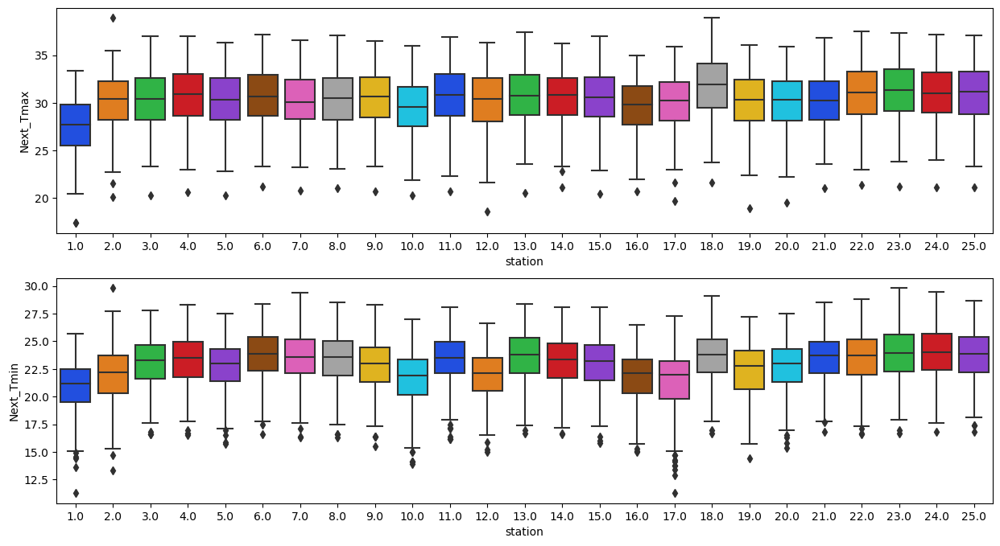

In [104]:
# Visualizing the realtion between station and target variables
plt.figure(figsize=(15,8))
plt.subplot(2,1,1)
sns.boxplot(df['station'],df['Next_Tmax'],data=df,palette="bright")
plt.subplot(2,1,2)
sns.boxplot(df['station'],df['Next_Tmin'],data=df,palette="bright")

#### From the box plot we can notice the station 18 has highest temperature collection for both Next_Tmax and Next_Tmin targets while station 1 observes lowest temperature for both the targets. This could be because of the stations location



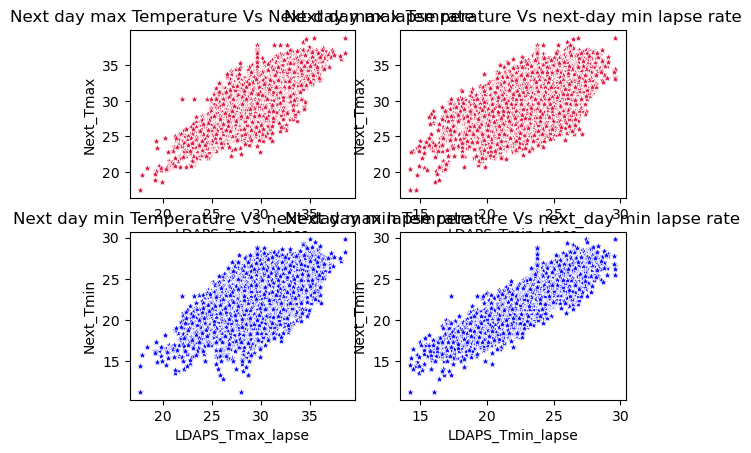

<Figure size 640x480 with 0 Axes>

In [105]:
plt.subplot(2, 2, 1)

# Adding a title to the subplot
plt.title('Next day max Temperature Vs Next-day max lapse rate')

# Creating a scatter plot using Seaborn
sns.scatterplot(x='LDAPS_Tmax_lapse', y='Next_Tmax', data=df, marker="*", color='crimson')


plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day min lapse rate')
sns.scatterplot(x='LDAPS_Tmin_lapse',y='Next_Tmax',data=df,marker="*",color='crimson')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day max lapse rate')
sns.scatterplot(x='LDAPS_Tmax_lapse',y='Next_Tmin',data=df,marker="*",color='b')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day min lapse rate')
sns.scatterplot(x='LDAPS_Tmin_lapse',y='Next_Tmin',data=df,marker="*",color="b")
plt.show()
# Display the plot
plt.tight_layout()
plt.show()

#### There is a strong positive linear relationship between target variables Next day temperature and Next day air temperature applied lapse rate.

#### As Next day air temperature applied lapse rate increases, Next day temperature is also increasing.

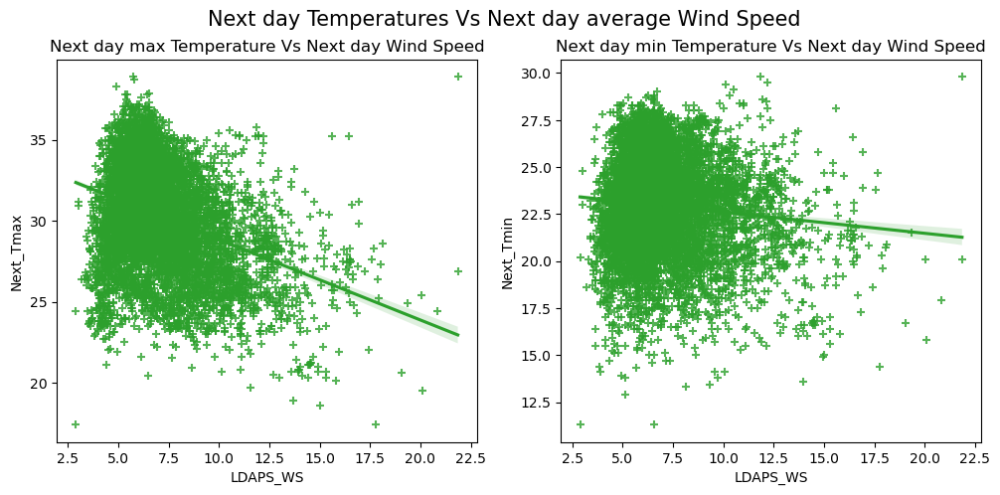

In [106]:
# Comparing Next day temperature and  Next day Average Wind Speed

plt.figure(figsize=(12,5))
plt.suptitle('Next day Temperatures Vs Next day average Wind Speed',fontsize=15)

plt.subplot(1,2,1)
plt.title('Next day max Temperature Vs Next day Wind Speed') 
sns.regplot(x='LDAPS_WS',y='Next_Tmax',data=df,marker='+',color="tab:green")

plt.subplot(1,2,2)
plt.title('Next day min Temperature Vs Next day Wind Speed') 
sns.regplot(x='LDAPS_WS',y='Next_Tmin',data=df,marker='+',color="tab:green")
plt.show()

#### LDAPS_WS is forecast of next-day average wind speed in (m/s).

#### There is very less relation of wind speed with the target variables. As wind speed increases, Next day temperature decreases also Next day Tmax seems to decrease more drastically compared to Next day Tmin.

#### From the graph we can observe the Wind Speed is mostly 2.8 to 10 m/s.

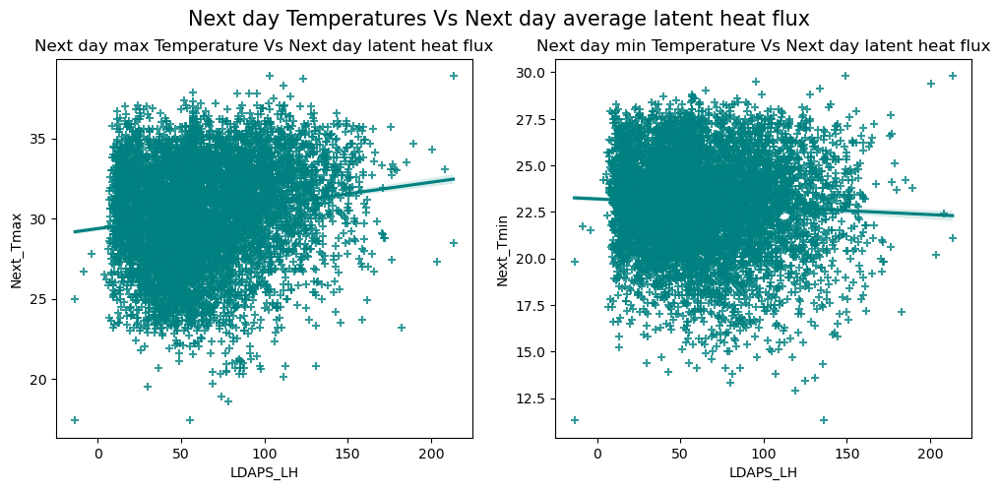

In [107]:
#Comparing Next day temperature and  Next day Average latent heat flux (W/m2)

plt.figure(figsize=(12,5))
plt.suptitle('Next day Temperatures Vs Next day average latent heat flux',fontsize=15)

plt.subplot(1,2,1)
plt.title('Next day max Temperature Vs Next day latent heat flux') 
sns.regplot(x='LDAPS_LH',y='Next_Tmax',data=df,marker='+',color="teal")

plt.subplot(1,2,2)
plt.title('Next day min Temperature Vs Next day latent heat flux') 
sns.regplot(x='LDAPS_LH',y='Next_Tmin',data=df,marker='+',color="teal")
plt.show()

#### From the plot we can notice there is no linear relation between targets and the features.

#### As Latent heat flux increases, Next day Tmax is also increases slightly while Next day Tmin decreases.


#### The Latent heat flux mostly distributed in the range of 10 to 160 W/m2.

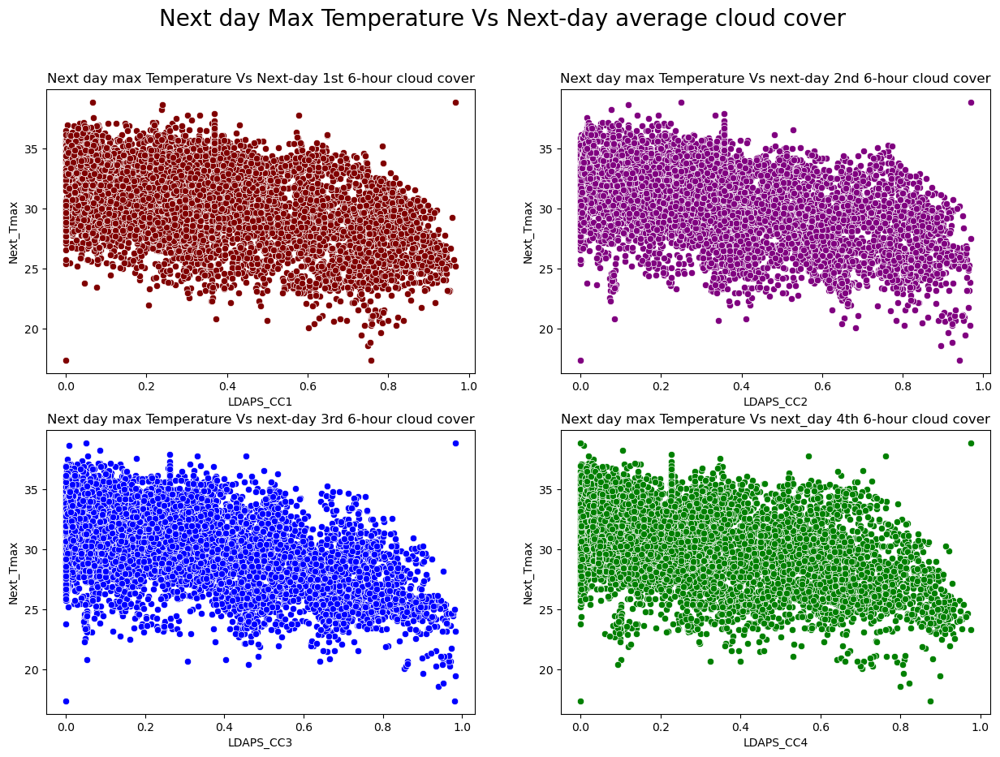

In [108]:
# Comparing Next day maximnum temperature and next day average cloud cover

plt.figure(figsize=(15,10))
plt.suptitle('Next day Max Temperature Vs Next-day average cloud cover',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day 1st 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC1',y='Next_Tmax',data=df,color="maroon")

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day 2nd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC2',y='Next_Tmax',data=df,color='purple')

plt.subplot(2,2,3)
plt.title('Next day max Temperature Vs next-day 3rd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC3',y='Next_Tmax',data=df,color='b')

plt.subplot(2,2,4)
plt.title('Next day max Temperature Vs next_day 4th 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC4',y='Next_Tmax',data=df,color="g")
plt.show()

#### By observing the plot we can infer that the column Next_Tmax goes on decreasing as the cloud cover increases irrespective of any split.

#### The cloud cover liesin the range of 0 to 0.97%. Also we can say there is negative linear relation between the targets and the cloud cover.

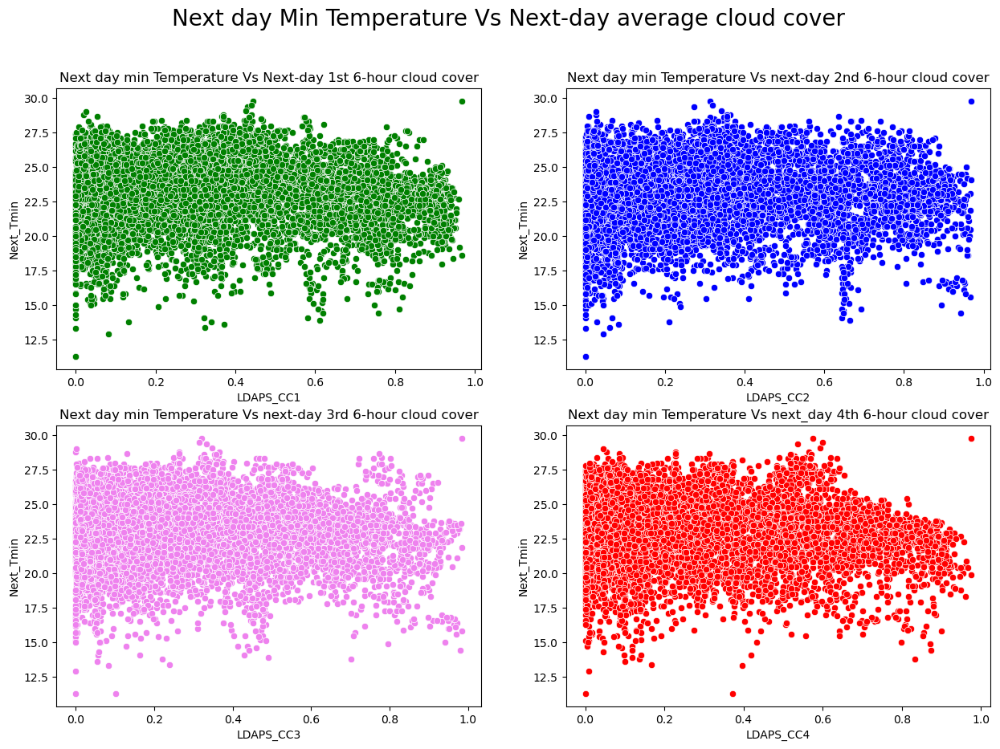

In [109]:
# Comparing Next day minimum temperature and next day average cloud cover

plt.figure(figsize=(15,10))
plt.suptitle('Next day Min Temperature Vs Next-day average cloud cover',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs Next-day 1st 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC1',y='Next_Tmin',data=df,color="g")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs next-day 2nd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC2',y='Next_Tmin',data=df,color='b')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day 3rd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC3',y='Next_Tmin',data=df,color='violet')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day 4th 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC4',y='Next_Tmin',data=df,color="r")
plt.show()

#### There is no significant relation between Next day temperature and cloud cover.

#### We can say that Next_Tmin remains unaffected by cloud cover. And it ranges between 0-0.98% .

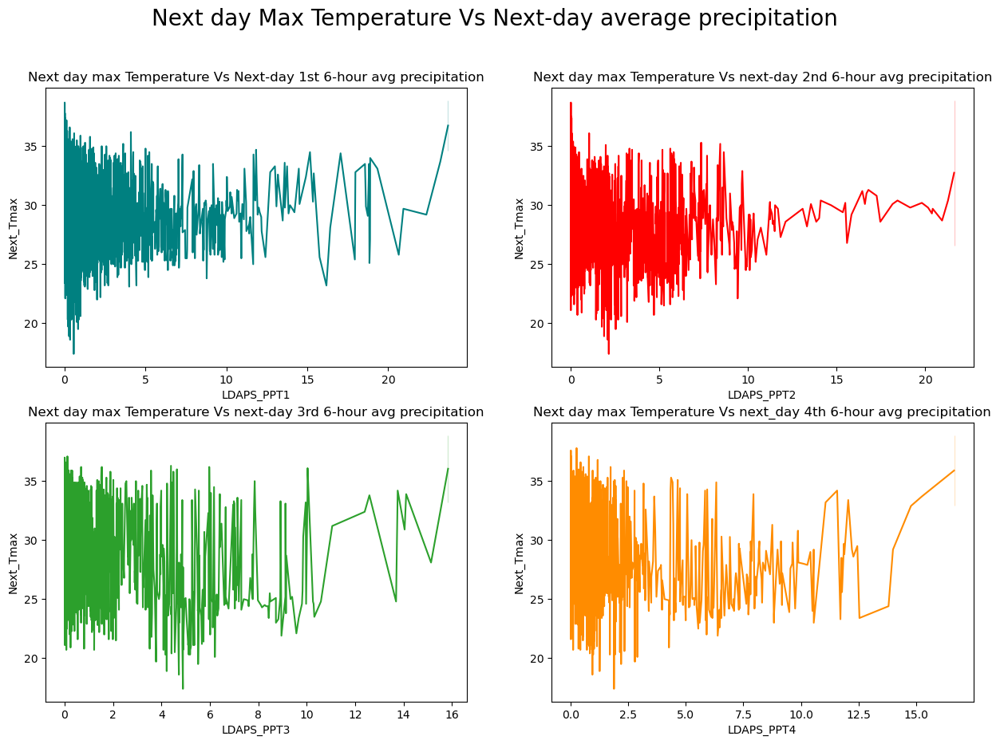

In [110]:
# Comparing Next day maximnum temperature and next day average precipitation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Max Temperature Vs Next-day average precipitation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day 1st 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT1',y='Next_Tmax',data=df,color="teal")

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day 2nd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT2',y='Next_Tmax',data=df,color='r')

plt.subplot(2,2,3)
plt.title('Next day max Temperature Vs next-day 3rd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT3',y='Next_Tmax',data=df,color='tab:green')

plt.subplot(2,2,4)
plt.title('Next day max Temperature Vs next_day 4th 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT4',y='Next_Tmax',data=df,color="darkorange")
plt.show()

#### There is no relation between average precipitation and Next day temperature.

#### Next_Tmax decreases as average precipitation increases irrespective of any split.

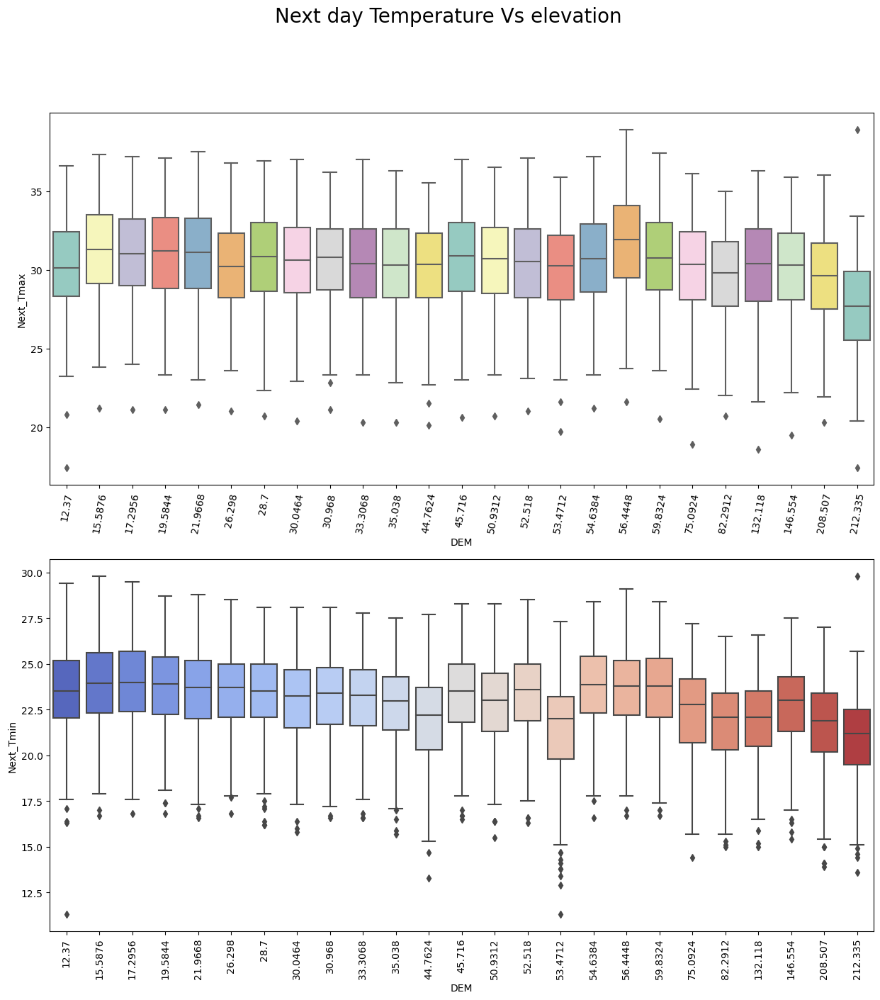

In [111]:
# Comparing Next day temperature and elevation

plt.figure(figsize=(15,15))
plt.suptitle('Next day Temperature Vs elevation',fontsize=20)

plt.subplot(2,1,1)
sns.boxplot(x='DEM',y='Next_Tmax',data=df,palette="Set3")
plt.xticks(rotation=80)

plt.subplot(2,1,2)
sns.boxplot(x='DEM',y='Next_Tmin',data=df,palette="coolwarm")
plt.xticks(rotation=90)
plt.show()

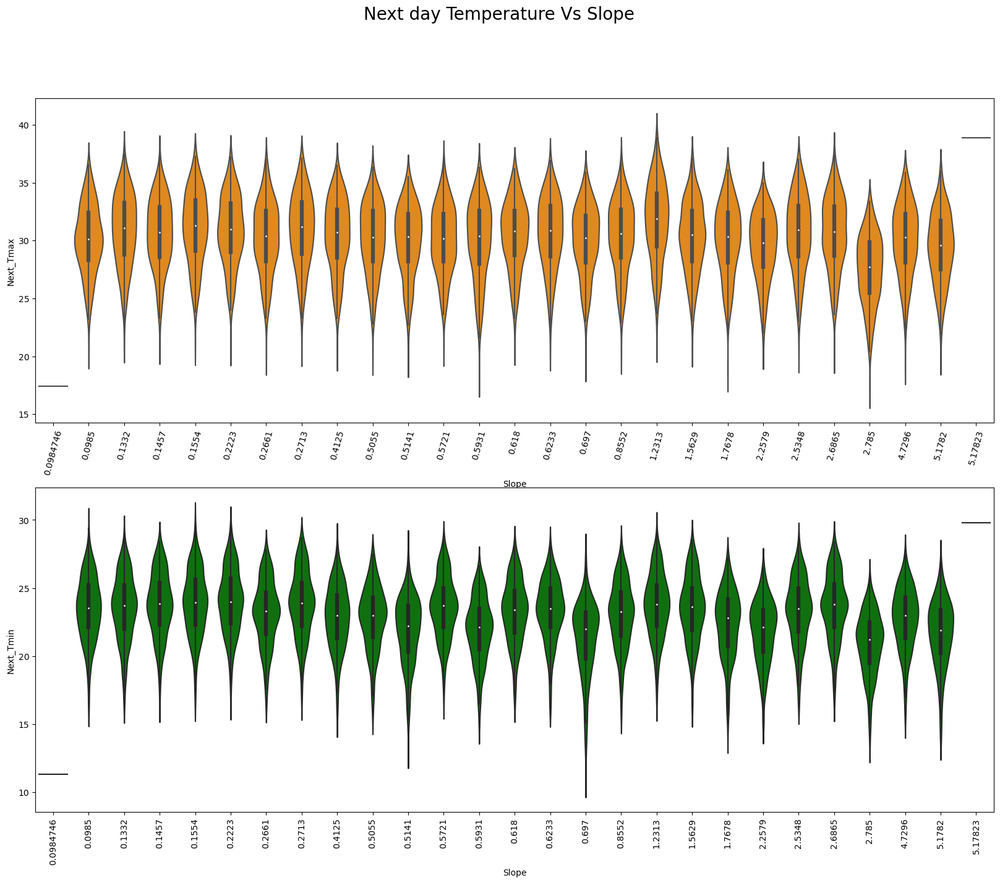

In [112]:
# Comparing Next day temperature and slope

plt.figure(figsize=(20,15))
plt.suptitle('Next day Temperature Vs Slope',fontsize=20)

plt.subplot(2,1,1)
sns.violinplot(x='Slope',y='Next_Tmax',data=df,color="darkorange")
plt.xticks(rotation=75)

plt.subplot(2,1,2)
sns.violinplot(x='Slope',y='Next_Tmin',data=df,color="g")
plt.xticks(rotation=90)
plt.show()

#### From the graph we can see as the slopes increases, the temperature also increases in both the cases.

#### Lowest and highest temperatures observed at consecutive slopes 2.785 and 1.2313 respectively in both the cases.

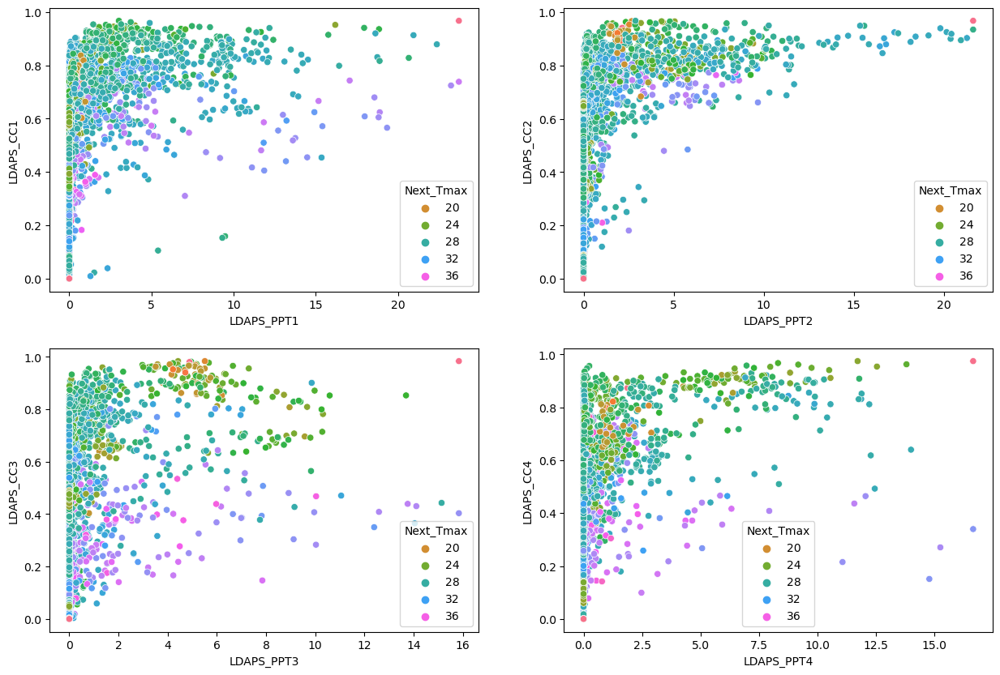

In [113]:
plt.figure(figsize=(15,10))

plt.subplot(2,2,1)
sns.scatterplot(x='LDAPS_PPT1',y='LDAPS_CC1',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,2)
sns.scatterplot(x='LDAPS_PPT2',y='LDAPS_CC2',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,3)
sns.scatterplot(x='LDAPS_PPT3',y='LDAPS_CC3',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,4)
sns.scatterplot(x='LDAPS_PPT4',y='LDAPS_CC4',hue='Next_Tmax',data=df,palette="husl")
plt.show()



#### In all the graphs the Next_Tmax is higher when the precipitation and cloud cover both have lower value.

#### In the first split of cloud cover and precipitation , precipitation increases after the cloud cover value crosses 0.2 while this threshold increases to 0.5 in 2nd split after that it decreses for all the splits.

#### We can observe the presence of outliers from the graph.

# Multivariate Analysis

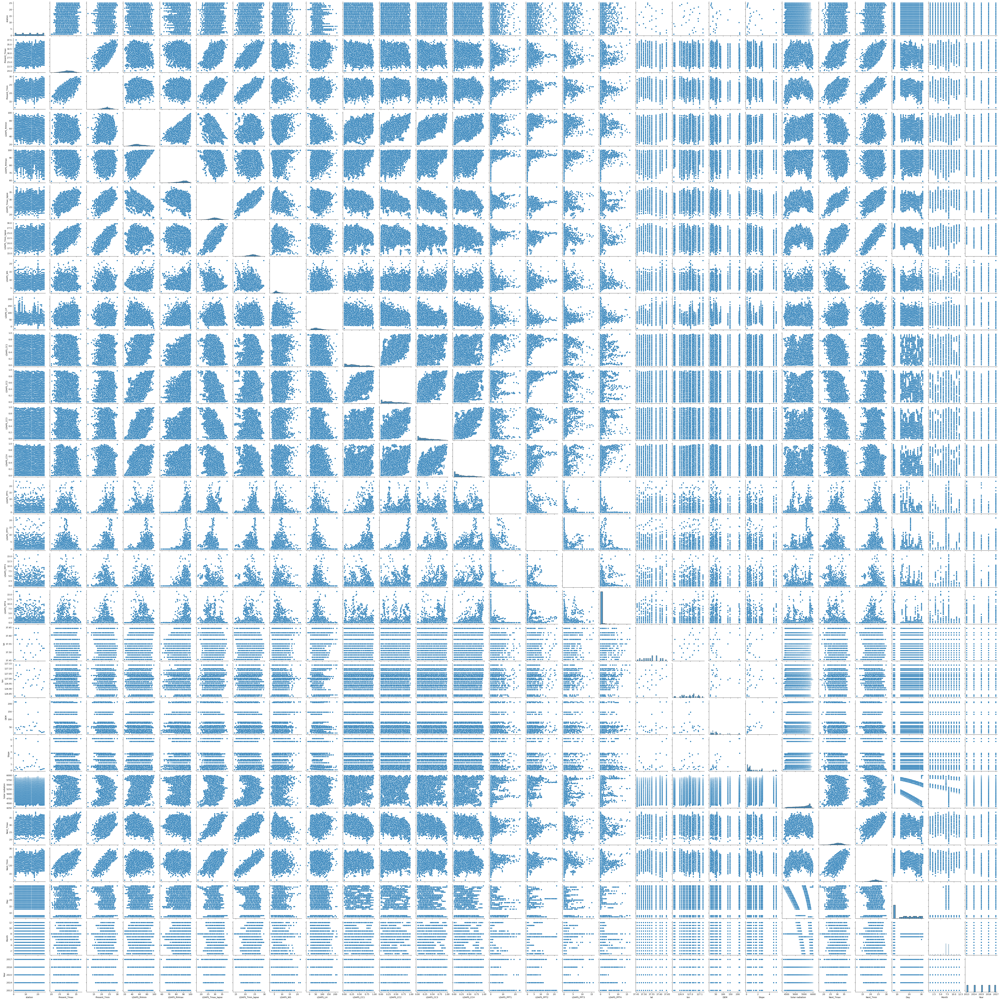

In [114]:
# Checking the pairwise relation between the features and label Next_Tmax.
sns.pairplot(df,palette="husl")

#### The pairplot gives the pairwise relation between the features on the basis of the targets Next_Tmax. On the diagonal we can notice the distribution plots in the pairplots.

#### We can notice most of the feature have strong linear relationship with each other and also we can observe the presence of outliers in many columns. We will indentify the outliers using boxplots.

# Checking for outliers

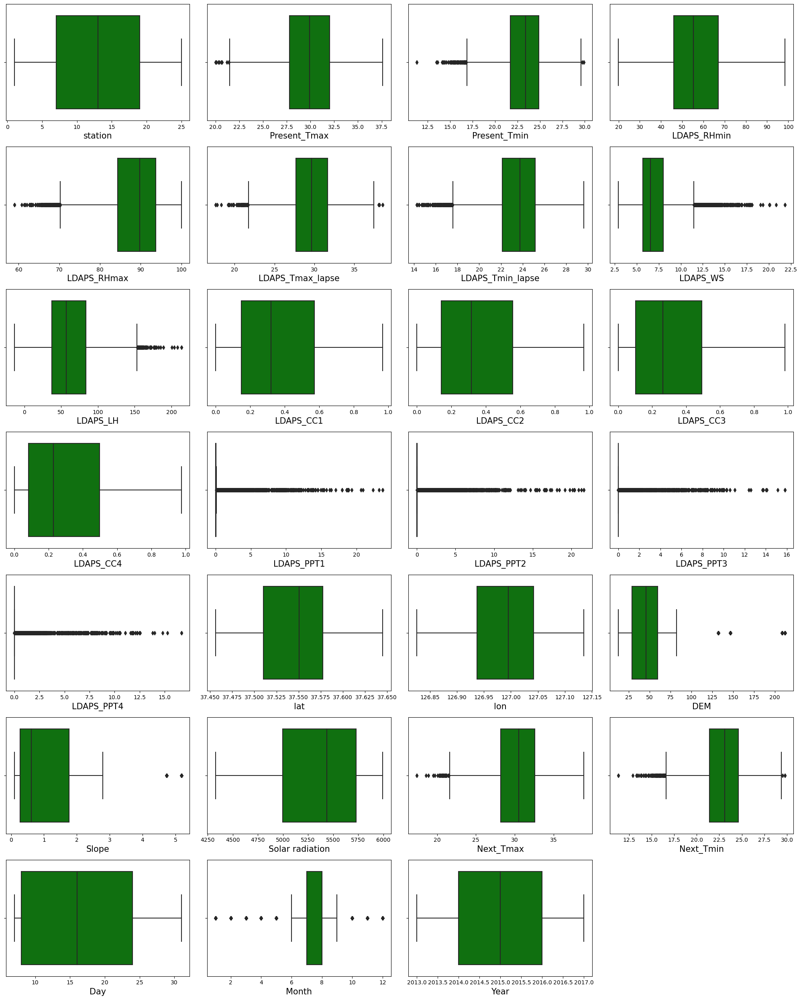

In [115]:
# Checking for outliers present in the dataset
plt.figure(figsize=(20,25),facecolor="white")
plotnumber=1
for col in df.columns:
    if plotnumber<=27:
        ax = plt.subplot(7,4,plotnumber)
        sns.boxplot(df[col],color='g')
        plt.xlabel(col,fontsize=15)
    plotnumber+=1
plt.tight_layout()

### Removing outliers

# Zscore method

In [116]:
# Features containing outliers
features = df[['Present_Tmax','Present_Tmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Month']]
from scipy.stats import zscore
z = np.abs(zscore(features))
z

,Present_Tmax,Present_Tmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Month
0,0.361326,0.759529,0.381088,0.524889,0.217678,0.125893,0.208564,0.302656,0.273714,0.238242,0.222227,2.772243,1.115004,0.482972
1,0.721084,0.676296,0.309610,0.080895,0.222809,0.644345,0.313173,0.302656,0.273714,0.238242,0.222227,0.315157,0.542158,0.482972
2,0.619608,0.031188,0.616784,0.162936,0.450160,0.439018,1.247488,0.302656,0.273714,0.238242,0.222227,0.526218,0.723133,0.482972
3,0.754909,0.072805,1.130923,0.031092,0.080896,0.663593,0.097609,0.302656,0.273714,0.238242,0.222227,0.297588,0.932424,0.482972
4,0.551957,0.551446,0.246800,0.170325,0.012213,0.624511,1.355851,0.302656,0.273714,0.238242,0.222227,0.494322,0.548433,0.482972
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,2.187892,2.549048,1.329793,1.112066,2.030596,0.434099,0.286208,0.302656,0.273714,0.238242,0.222227,0.852681,0.803915,0.410691
7748,2.187892,2.299348,1.549810,0.887662,2.048660,0.252892,0.453062,0.302656,0.273714,0.238242,0.222227,0.821213,0.755095,0.410691
7749,2.221718,2.424198,1.556967,0.570780,2.138873,0.090494,1.589557,0.302656,0.273714,0.238242,0.222227,0.779043,0.719338,0.410691
7750,3.304127,4.962817,4.114586,4.087857,3.959959,1.936712,2.265567,0.302656,0.273714,0.238242,0.222227,0.911963,0.845455,0.410691


In [117]:
# Creating new dataframe
new_df = df[(z<3).all(axis=1)]
new_df

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,...,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,1.616969e-01,...,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,30,6,2013
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,1.594441e-01,...,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,30,6,2013
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,2.040915e-01,...,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,30,6,2013
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,1.611574e-01,...,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,30,6,2013
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,1.788925e-01,...,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,30,6,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,0.052902,0.030169,0.000000e+00,...,0.0,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,30,8,2017
7746,22.0,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,0.024518,5.850000e-07,...,0.0,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,30,8,2017
7747,23.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000e+00,...,0.0,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,30,8,2017
7748,24.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000e+00,...,0.0,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,30,8,2017


In [118]:
print(df.shape)
print(new_df.shape)

(7752, 27)
(6907, 27)


In [119]:
# Checking data loss
loss = (7752-6907)/7752*100
loss

10.900412796697626

#### Here we are losing more than 10% data. Lets check using IQR method.

# IQR(Inter Qunatile Range)

In [120]:
# 1st quantile
Q1 = features.quantile(0.25)

# 3rd quantile
Q3 = features.quantile(0.75)

# IQR
IQR = Q3-Q1

df1 = df[~((df<(Q1-1.5*IQR))|(df>(Q3+1.5*IQR))).any(axis=1)]

In [121]:
df1.shape

(2413, 27)

In [122]:
# Checking data loss
loss=(7752-2413)/7752*100
loss

68.87254901960785

#### By using both Zscore and IQR method we are losing more data. Its not suggestable to remove more than 10% of data as it may impact other variables.So we will keep the outliers as it is.

# Correlation

In [123]:
# Checking the correlation between features and label
cor = df.corr()
cor

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,...,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
station,1.000000,0.112806,0.132122,-0.066731,-0.166334,0.069363,0.105053,0.004353,-0.133693,0.006769,0.003223,0.000442,...,-0.015051,-0.013033,-0.237438,-0.118574,-0.256095,-0.090413,-0.018787,0.108289,0.128713,-0.000730,-0.000169,-0.000582
Present_Tmax,0.112806,1.000000,0.618760,-0.204571,-0.300322,0.570129,0.624216,-0.123582,0.134251,-0.311805,-0.213791,-0.145577,...,-0.122044,-0.101178,-0.052615,0.009020,-0.187121,-0.105809,-0.025439,0.610348,0.622741,-0.143899,-0.001185,0.059665
Present_Tmin,0.132122,0.618760,1.000000,0.123143,-0.012754,0.464151,0.764227,-0.037708,-0.011276,0.084447,0.090263,-0.005466,...,-0.049005,-0.065647,-0.078475,-0.043461,-0.250275,-0.146339,0.053578,0.471806,0.796670,-0.108728,-0.003550,0.036987
LDAPS_RHmin,-0.066731,-0.204571,0.123143,1.000000,0.579032,-0.564580,0.089471,0.294271,-0.070848,0.613818,0.745443,0.689513,...,0.240576,0.168555,0.087099,-0.076237,0.102115,0.123744,0.244080,-0.437898,0.095019,-0.065735,-0.053922,-0.001984
LDAPS_RHmax,-0.166334,-0.300322,-0.012754,0.579032,1.000000,-0.373334,-0.113914,0.134786,0.238183,0.436570,0.391256,0.226434,...,0.134087,0.117376,0.195761,0.025662,0.177134,0.219557,0.148259,-0.281341,-0.070246,-0.012803,-0.039040,-0.142223
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Next_Tmax,0.108289,0.610348,0.471806,-0.437898,-0.281341,0.827189,0.588206,-0.345619,0.155608,-0.452541,-0.490756,-0.517207,...,-0.196935,-0.181329,-0.053510,0.003052,-0.172538,-0.102725,0.008795,1.000000,0.621427,-0.116980,-0.026894,0.059732
Next_Tmin,0.128713,0.622741,0.796670,0.095019,-0.070246,0.586868,0.881059,-0.098767,-0.056906,-0.011028,0.031250,-0.056678,...,-0.064714,-0.105624,-0.083533,-0.046603,-0.246906,-0.146882,0.120212,0.621427,1.000000,-0.129726,-0.024524,0.022780
Day,-0.000730,-0.143899,-0.108728,-0.065735,-0.012803,-0.160495,-0.177770,-0.028982,-0.012227,-0.019928,0.004092,-0.053648,...,-0.003520,-0.020249,0.000053,-0.000063,0.000426,0.000462,-0.412987,-0.116980,-0.129726,1.000000,0.162019,0.000647
Month,-0.000169,-0.001185,-0.003550,-0.053922,-0.039040,-0.021745,-0.026990,-0.082375,-0.023536,-0.076224,-0.090616,-0.036878,...,0.035092,-0.071043,0.000012,-0.000015,0.000099,0.000107,-0.309755,-0.026894,-0.024524,0.162019,1.000000,0.000150


#### This is the correlation between the dependent and independent variables. Lets visualize the correlation using heatmap.

<AxesSubplot:>

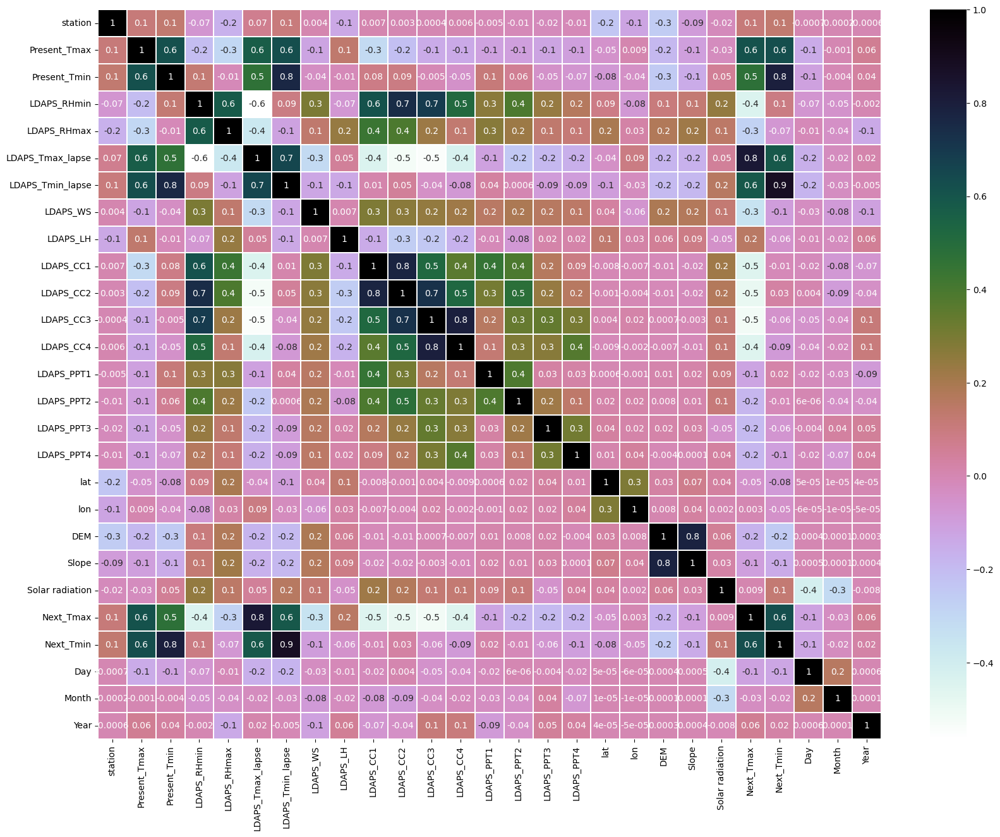

In [124]:
# Visualizing the correlation matrix 
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(),linewidths=.1,fmt=".1g",annot=True,cmap="cubehelix_r")


#### This heatmap contains both positive and negative correlation.

# 1. Prediction for Next_Tmax

### Visualizing the correlation between label Next_Tmax and features

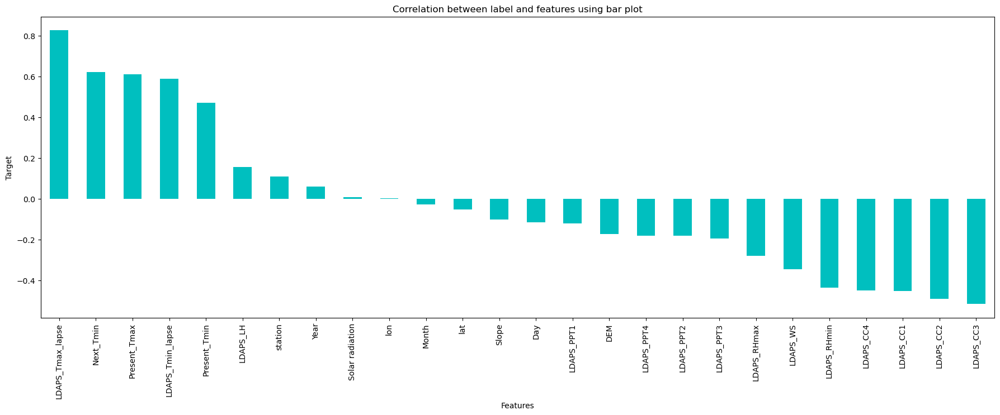

In [125]:
plt.figure(figsize=(22,7))
df.corr()['Next_Tmax'].sort_values(ascending=False).drop("Next_Tmax").plot(kind="bar",color='c')
plt.xlabel("Features",fontsize=10)
plt.ylabel("Target",fontsize=10)
plt.title("Correlation between label and features using bar plot")
plt.show()

#### The columns longitude and Solar radiation have very less correlation with the label. So we can drop these columns.

`

In [126]:
x = df.drop("Next_Tmax",axis=1) #Separating features and label
y = df["Next_Tmax"]

In [127]:
x.shape

(7752, 26)

In [128]:
y.shape

(7752,)

# Checking for skewness

In [129]:
x.skew()

station            0.000182
Present_Tmax      -0.264137
Present_Tmin      -0.367538
LDAPS_RHmin        0.300220
LDAPS_RHmax       -0.860210
                     ...   
Solar radiation   -0.511210
Next_Tmin         -0.404447
Day                0.245283
Month             -0.705586
Year              -0.000365
Length: 26, dtype: float64

## Removing skewness using yeo-johnson method

In [130]:
# Making the skew less than or equal to +0.5 and -0.5 for better prediction using yeo-johnson method
skew=['LDAPS_RHmax','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Solar radiation','Month']

from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')


In [131]:
x[skew] = scaler.fit_transform(x[skew].values)
x[skew].head()

,LDAPS_RHmax,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Solar radiation,Month
0,0.269762,-0.314003,0.097757,0.312316,-0.538372,-0.580369,-0.557339,-0.519114,-0.492283,-0.444377,1.834978,1.314153,1.849430,-0.582534
1,0.182577,0.142820,-0.622109,-0.209702,-0.550844,-0.599240,-0.557339,-0.519114,-0.492283,-0.444377,0.055979,-0.385336,1.400702,-0.582534
2,-0.776602,0.393133,-0.310859,-1.373795,-0.313480,-0.515420,-0.557339,-0.519114,-0.492283,-0.444377,-0.364575,-0.949164,1.380650,-0.582534
3,1.315999,-0.176064,-0.653345,0.206140,-0.541353,-0.560937,-0.557339,-0.519114,-0.492283,-0.444377,0.084879,1.235263,1.357783,-0.582534
4,0.107639,-0.105479,-0.590312,1.301881,-0.444948,-0.360509,-0.557339,-0.519114,-0.492283,-0.444377,-0.290442,-0.401730,1.366748,-0.582534


In [132]:

x.skew()

station            0.000182
Present_Tmax      -0.264137
Present_Tmin      -0.367538
LDAPS_RHmin        0.300220
LDAPS_RHmax       -0.116481
                     ...   
Solar radiation   -0.176636
Next_Tmin         -0.404447
Day                0.245283
Month              0.043780
Year              -0.000365
Length: 26, dtype: float64

#### The skewness has been removed from all the columns except LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3 and LDAPS_PPT1. Lets remove the skewness from these columns using log transformation.

In [133]:
# Removing skewness usinf log transformation
x['LDAPS_PPT1'] = np.log1p(x['LDAPS_PPT1'])
x['LDAPS_PPT2'] = np.log1p(x['LDAPS_PPT2'])
x['LDAPS_PPT3'] = np.log1p(x['LDAPS_PPT3'])
x['LDAPS_PPT4'] = np.log1p(x['LDAPS_PPT4'])

In [134]:
x.skew()

station            0.000182
Present_Tmax      -0.264137
Present_Tmin      -0.367538
LDAPS_RHmin        0.300220
LDAPS_RHmax       -0.116481
                     ...   
Solar radiation   -0.176636
Next_Tmin         -0.404447
Day                0.245283
Month              0.043780
Year              -0.000365
Length: 26, dtype: float64

#### Tried removing skewness from LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3 and LDAPS_PPT4 using yeo-johnson and log transformation methods but the skewness has not been removed but it got reduced. Lets check the distribution afetr removing skewness

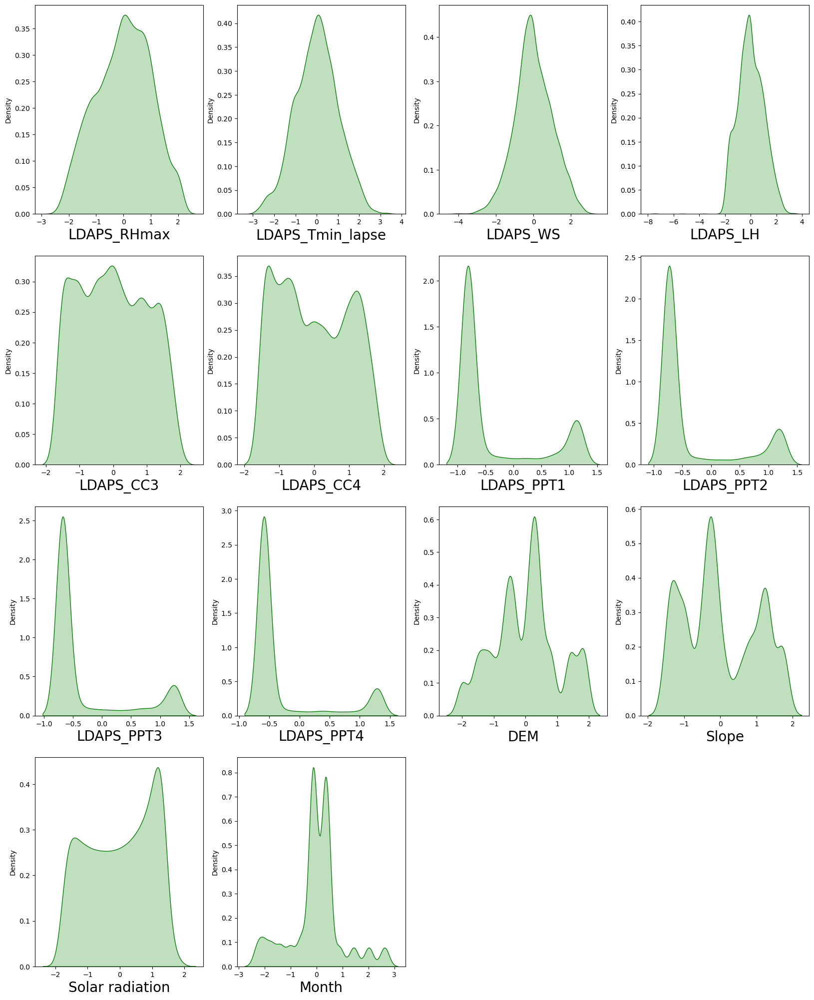

In [135]:
# After removing skewness let's check how the data has been distributed in each column.

plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in x[skew]:
    if plotnumber<=14:
        ax = plt.subplot(4,4,plotnumber)
        sns.distplot(x[column],color='g',kde_kws={"shade": True},hist=False)
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()

# Checking for Multicolinearity

In [136]:
# Finding variance inflation factor in each scaled column 

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,5.403028e+00,station
1,2.960821e+02,Present_Tmax
2,3.281116e+02,Present_Tmin
3,1.064745e+02,LDAPS_RHmin
4,2.691651e+00,LDAPS_RHmax
...,...,...
21,1.521548e+00,Solar radiation
22,5.108563e+02,Next_Tmin
23,6.286307e+00,Day
24,1.124323e+00,Month


In [137]:
The column Next_Tmin has VIF value greater than 10, we will remove this to overcome with the issue of multicollinearity. After dropping the column will check VIF again, if we find the value above 10 then we will remove that column having high VIF. This process will continue until we get the VIF value less than 10.


SyntaxError: invalid syntax (1864124401.py, line 1)

In [ ]:
# Dropping Next_Tmin column
x.drop("Next_Tmin",axis=1,inplace=True)

In [ ]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

#### The column LDAPS_Tmax_lapse has High VIF value compare to other columns. Let's drop it.

In [ ]:
# Dropping LDAPS_Tmax_lapse column
x.drop("LDAPS_Tmax_lapse",axis=1,inplace=True)

In [ ]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

In [ ]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

# Modeling

In [ ]:
from sklearn.ensemble import RandomForestRegressor
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state=i)
    mod = RandomForestRegressor()
    mod.fit(x_train, y_train)
    pred = mod.predict(x_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum r2 score is ",maxAccu," on Random_state ",maxRS)

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=maxRS)


In [ ]:
# Checking R2 score for RandomForestRegressor
RFR = RandomForestRegressor()
RFR.fit(x_train,y_train)
predRFR = RFR.predict(x_test)
print("R2_score:",r2_score(y_test,predRFR))
print("MAE:",metrics.mean_absolute_error(y_test,predRFR))
print("MSE:",metrics.mean_squared_error(y_test,predRFR))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predRFR)))

# Visualizing the predicted values
sns.regplot(y_test,predRFR,color="crimson")
plt.show()

In [ ]:
# Checking R2 score for DecisionTreeRegressor
DTR = DecisionTreeRegressor()
DTR.fit(x_train,y_train)
predDTR = DTR.predict(x_test)
print("R2_score:",r2_score(y_test,predDTR))
print("MAE:",metrics.mean_absolute_error(y_test,predDTR))
print("MSE:",metrics.mean_squared_error(y_test,predDTR))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predDTR)))

# Visualizing the predicted values
sns.regplot(y_test,predDTR,color="crimson")
plt.show()

In [ ]:
# Checking R2 score for GradientBoostingRegressor
GB = GradientBoostingRegressor()
GB.fit(x_train,y_train)
predGB = GB.predict(x_test)
print("R2_score:",r2_score(y_test,predGB))
print("MAE:",metrics.mean_absolute_error(y_test,predGB))
print("MSE:",metrics.mean_squared_error(y_test,predGB))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predGB)))

# Visualizing the predicted values
sns.regplot(y_test,predGB,color="crimson")
plt.show()

In [ ]:
# Checking R2 score for BaggingRegressor
BR = BaggingRegressor()
BR.fit(x_train,y_train)
predBR = BR.predict(x_test)
print("R2_score:",r2_score(y_test,predBR))
print("MAE:",metrics.mean_absolute_error(y_test,predBR))
print("MSE:",metrics.mean_squared_error(y_test,predBR))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predBR)))

# Visualizing the predicted values
sns.regplot(y_test,predBR,color="crimson")
plt.show()

In [ ]:
# Checking R2 score for XGB Regressor
from xgboost import XGBRegressor as xgb

XGB=xgb()
XGB.fit(x_train,y_train)
predXGB = XGB.predict(x_test)
print("R2_score:",r2_score(y_test,predXGB))
print("MAE:",metrics.mean_absolute_error(y_test,predXGB))
print("MSE:",metrics.mean_squared_error(y_test,predXGB))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predXGB)))

# Visualizing the predicted values
sns.regplot(y_test,predXGB,color="crimson")
plt.show()

In [ ]:
# Checking R2 score for ExtraTreesRegressor
ET = ExtraTreesRegressor()
ET.fit(x_train,y_train)
predET = ET.predict(x_test)
print("R2_score:",r2_score(y_test,predET))
print("MAE:",metrics.mean_absolute_error(y_test,predET))
print("MSE:",metrics.mean_squared_error(y_test,predET))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predET)))

# Visualizing the predicted values
sns.regplot(y_test,predET,color="crimson")
plt.show()

# Checking Cross Validation score 

In [ ]:
# Checking cv score for Random Forest Regressor
score=cross_val_score(RFR,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predRFR)-abs(score.mean()))


In [ ]:
# Checking cv score for Decision Tree Regressor
score=cross_val_score(DTR,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predDTR)-abs(score.mean()))

In [ ]:
# Checking cv score for ExtraTreesRegressor
score=cross_val_score(ET,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predET)-abs(score.mean()))


In [ ]:
# Checking cv score for Gradient Boosting Regressor
score=cross_val_score(GB,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predGB)-abs(score.mean()))


In [ ]:
# Checking cv score for Bagging Regressor
score=cross_val_score(BR,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predBR)-abs(score.mean()))


In [ ]:
# Checking cv score for XGBRegressor
score=cross_val_score(XGB,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predXGB)-abs(score.mean()))

#### From the differences between the R2 score and Cross Validation Score we can conclude that XGB Regressor as our best fitting model. We will perform Hyper parameter tuning on the best model.

# Hyper parameter tuning

In [ ]:
#XGB Regressor

parameters = {'n_estimators' : [50,100,150,200],
              'learning_rate':np.arange(0.05,0.5,0.05),
              'gamma' : np.arange(0,0.5,0.1),
              'max_depth' : [4, 6, 8,10]}

In [ ]:
GCV=GridSearchCV(xgb(),parameters,cv=5)

In [ ]:
GCV.fit(x_train,y_train)

In [ ]:
GCV.best_params_

In [ ]:
Final_model1 = xgb(gamma=0.30000000000000004, learning_rate=0.1, max_depth=8, n_estimators=200)
Final_model1.fit(x_train, y_train)
pred = Final_model1.predict(x_test)
print('R2_Score:',r2_score(y_test,pred)*100)
print("RMSE value:",np.sqrt(metrics.mean_squared_error(y_test, pred)))
print('MAE:',metrics.mean_absolute_error(y_test, pred))
print('MSE:',metrics.mean_squared_error(y_test, pred))

# Visualizing the predicted values
sns.regplot(y_test,pred,color="g")
plt.show()

#### After hyper parameter tuning our best model accuracy increased and giving 92.29% which is very good.

# Saving the model

In [ ]:
import joblib
joblib.dump(Final_model1,"Temperature_Forecast_Next_Tmax.pkl")

# Predicting the saved model

In [ ]:
# Loading the saved model
Model = joblib.load("Temperature_Forecast_Next_Tmax.pkl")

# prediction
a = np.array(y_test)
predicted = np.array(Model.predict(x_test))
df_com = pd.DataFrame({"Original":a,"Predicted":predicted},index= range(len(a)))
df_com